In [3]:
library('ggplot2')
library('reshape2')
library('ggpubr')
library(glmnet)
library(doMC)
library(survival)
library(data.table)
library(mltools)
library(CoxBoost)
library(randomForestSRC)
library(CoxHD)
library(Hmisc)
library(gridExtra)
library("survminer")
library(dplyr)
library(stringr)

source("../../../../src/tools.R")
options(repr.plot.res        = 100, # set a medium-definition resolution for the jupyter notebooks plots (DPI)
        repr.matrix.max.rows = 250, # set the maximum number of rows displayed
        repr.matrix.max.cols = 250) # set the maximum number of columns displayed

In [12]:
df_bootstrap <- NULL
for (l in list.files('../Bootstrap_coef/')){
    if (grepl("_bootstrap",l)){
        if(grepl("_bootstrap_SVM",l)){
            df_tmp <- read.table(paste('../Bootstrap_coef/',l,sep=""),sep=',',header=T)
            df_tmp <- df_tmp[,-1]
            df_tmp <- df_tmp[,c(2,1,3)]
        } else {
            df_tmp <- read.table(paste('../Bootstrap_coef/',l,sep=""))
        }
        colnames(df_tmp) <- c("feature","sum_coef","num_selected")
        df_tmp$model_algo <- str_sub(l, 1, str_length(l)-4)
        df_bootstrap <- rbind(df_bootstrap,df_tmp)   
    }
}
df_bootstrap <- df_bootstrap[df_bootstrap$feature!="age.1" & !is.na(df_bootstrap$feature),]
df_bootstrap$model <- sub("_bootstrap_.*$", "", df_bootstrap$model_algo )

In [13]:
# Model Containing all features

In [14]:
df_final <- read.table("../prognosis_dataframe.tsv")
eln <- colnames(df_final[,c(2,3,4)])
comp <- colnames(df_final[,c(184,198:213)])

all_gen <- c(5:88)
vect <- apply(X=df_final[,all_gen],2,FUN=function(x) 100*length(which(x==1))/dim(df_final)[1])
gen <- colnames(df_final[,match(names(vect[vect>=2]),names(df_final))])
              
all_cyto <- c(89:158)
vect <- apply(X=df_final[,all_cyto],2,FUN=function(x) 100*length(which(x==1))/dim(df_final)[1])
cyto <- colnames(df_final[,match(names(vect[vect>=2]),names(df_final))])
              
clin <- colnames(df_final[,c(159:165)])
demo <- colnames(df_final[,c(166:167)])

              
pal <- c(eln="#EE9937",comp="#59A08B",gen="#BFBFBF",cyto="#2b8cbe",clin="#870C14",demo="#a6bddb")    


In [15]:
### Check effect of del5 interesting
### effect of CHR SPLICING MULTIPLE CAPTURE A BIT BY AGE BECAUSE OF SRSF2 IN CHR SPLICING MULTIPLE WHEN WE LOOK AT MODEL WITH ALL COMPONENTS.

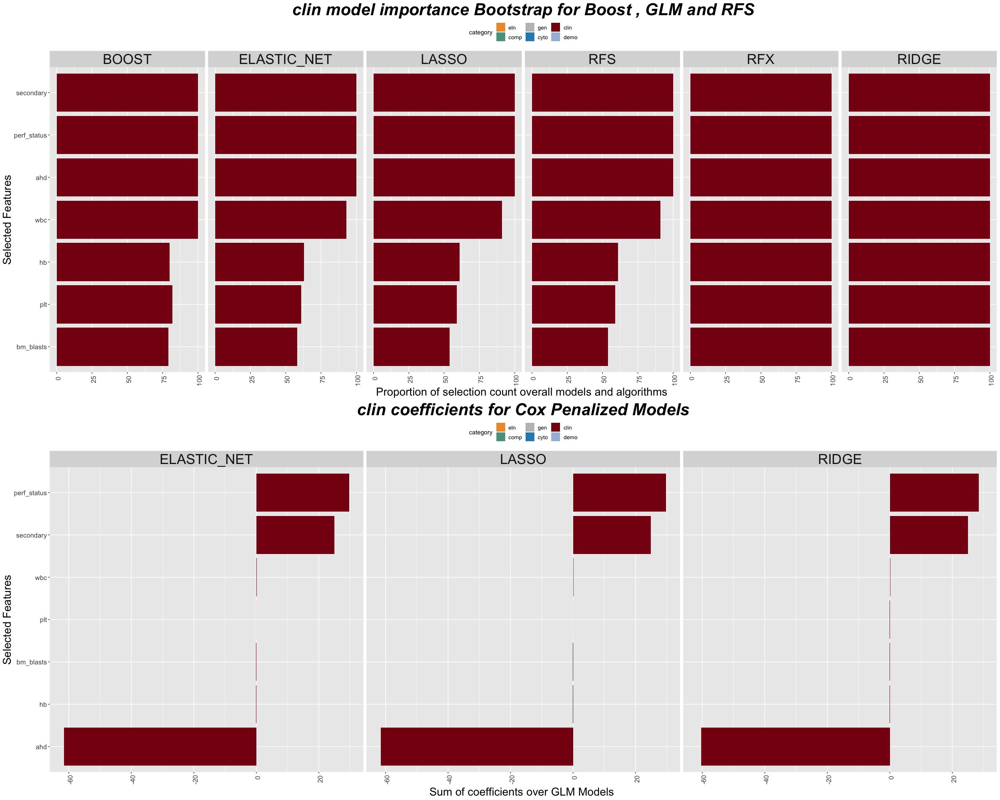

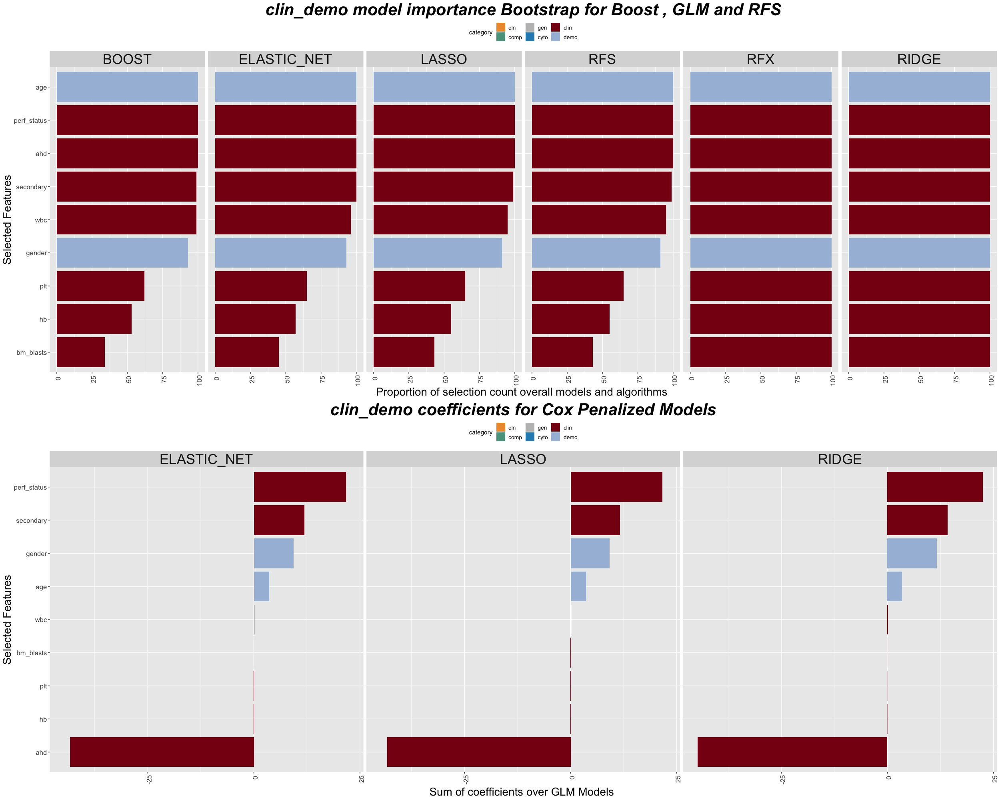

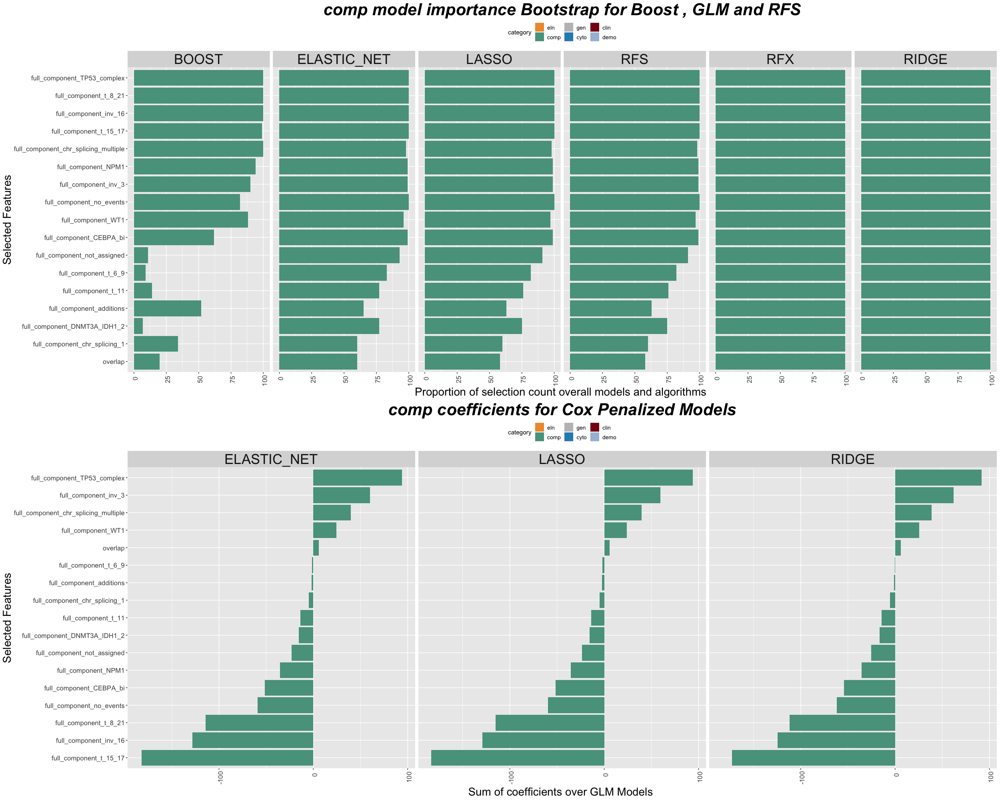

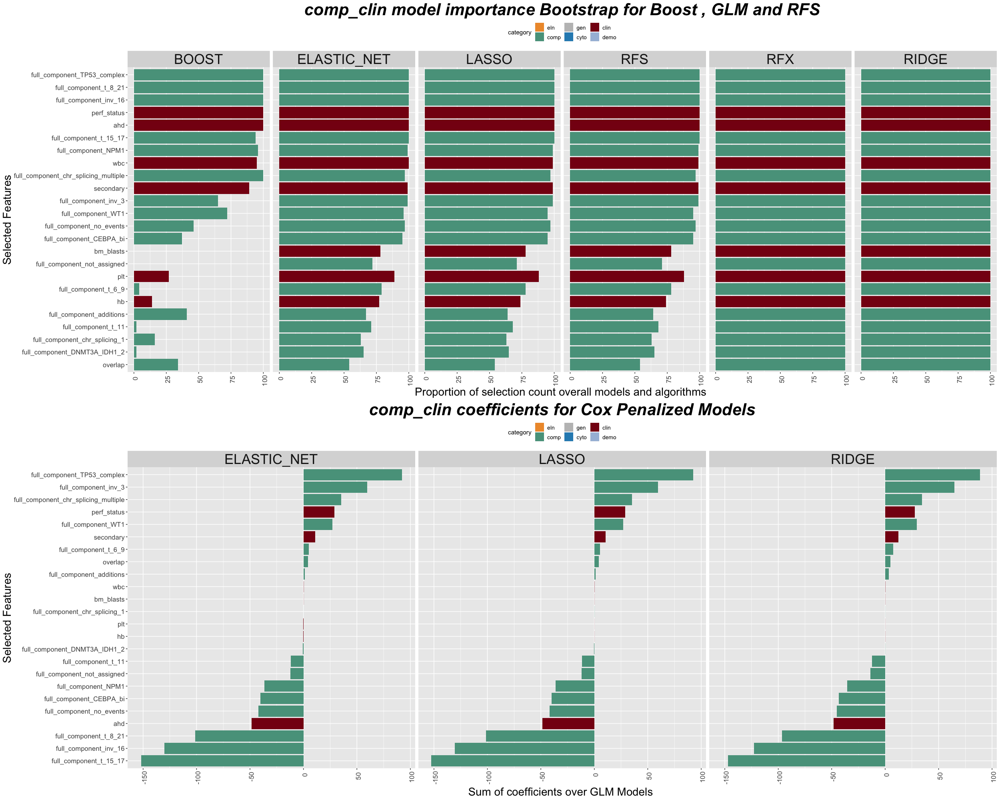

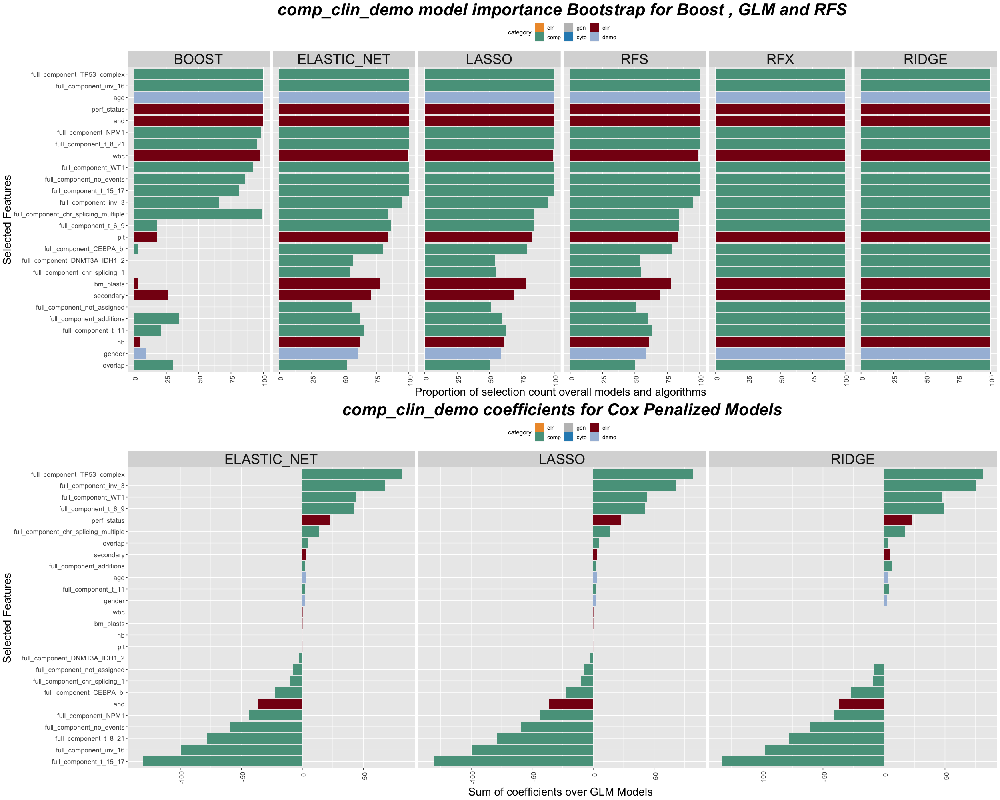

...

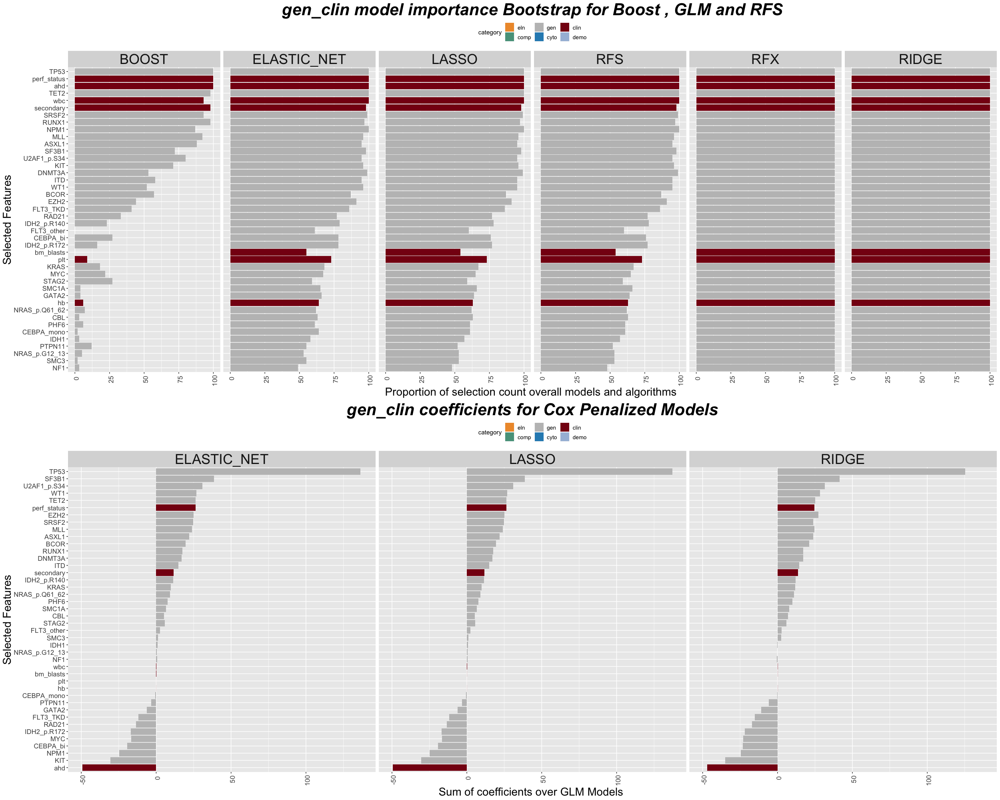

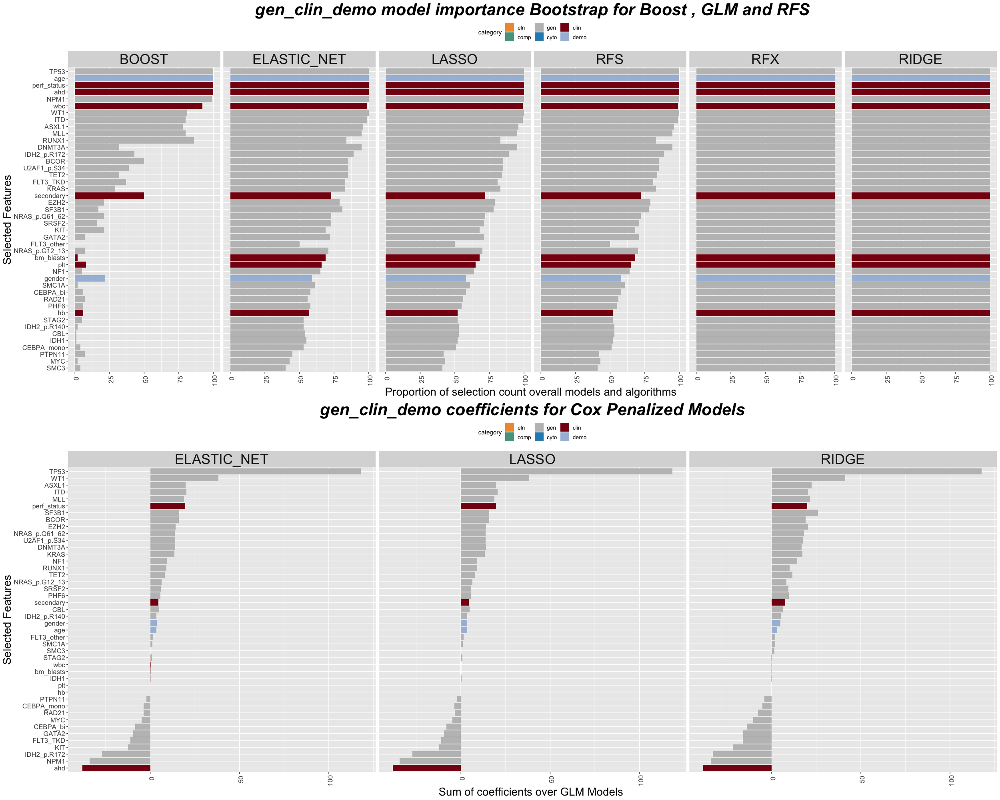

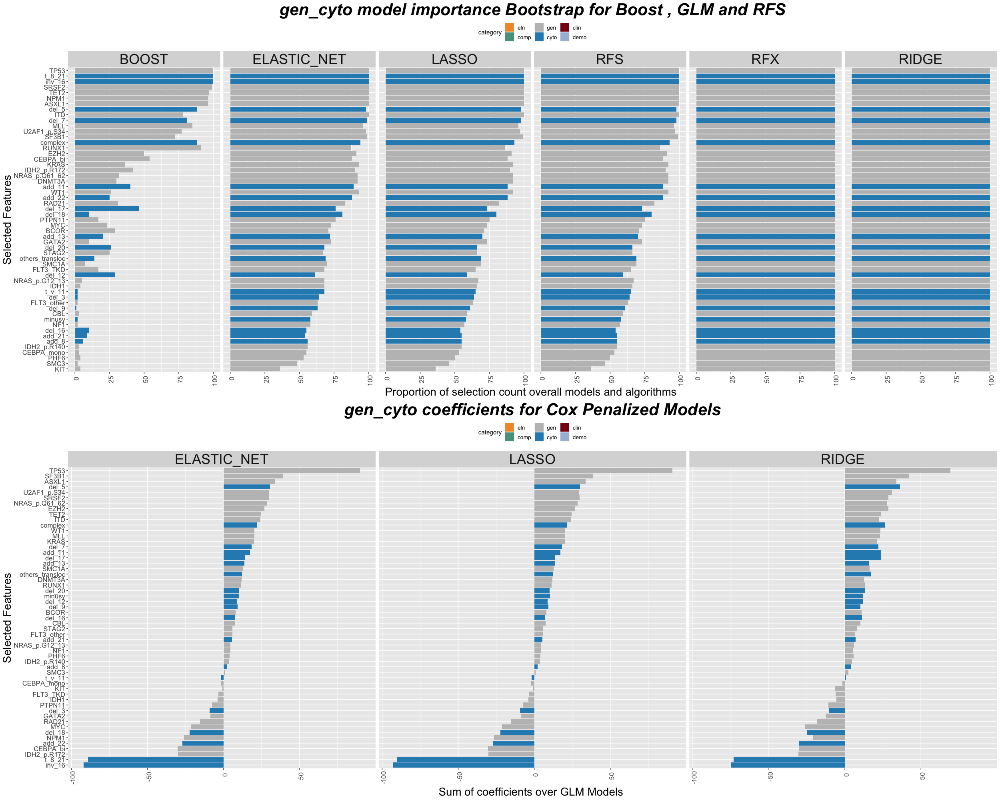

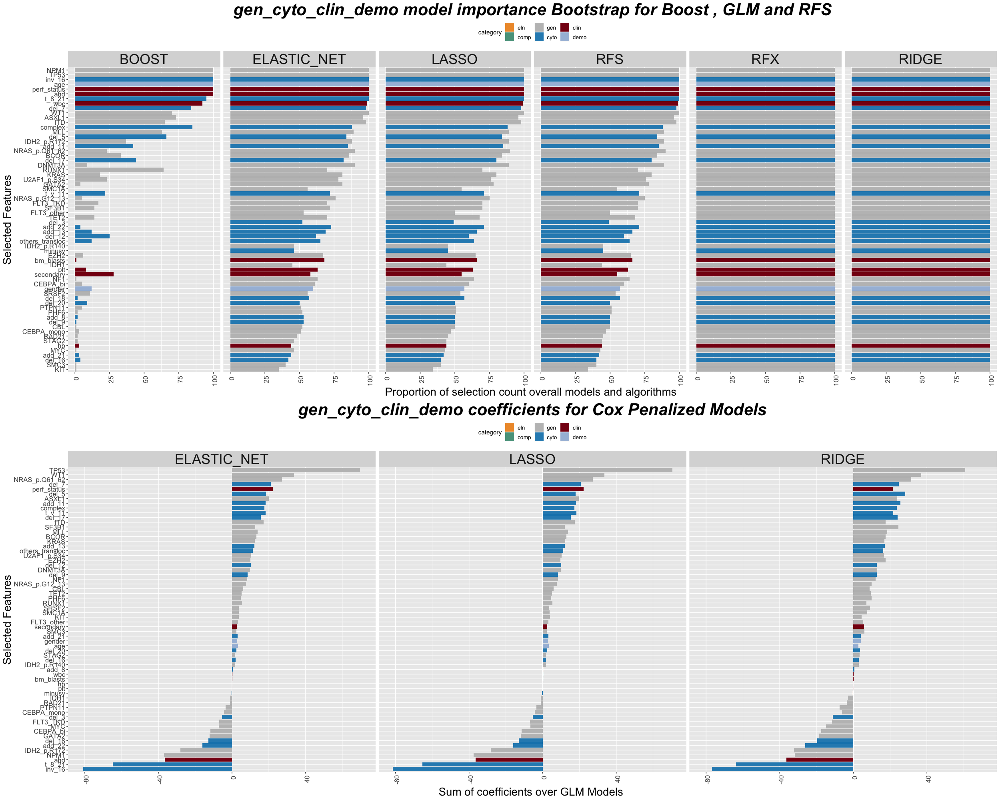

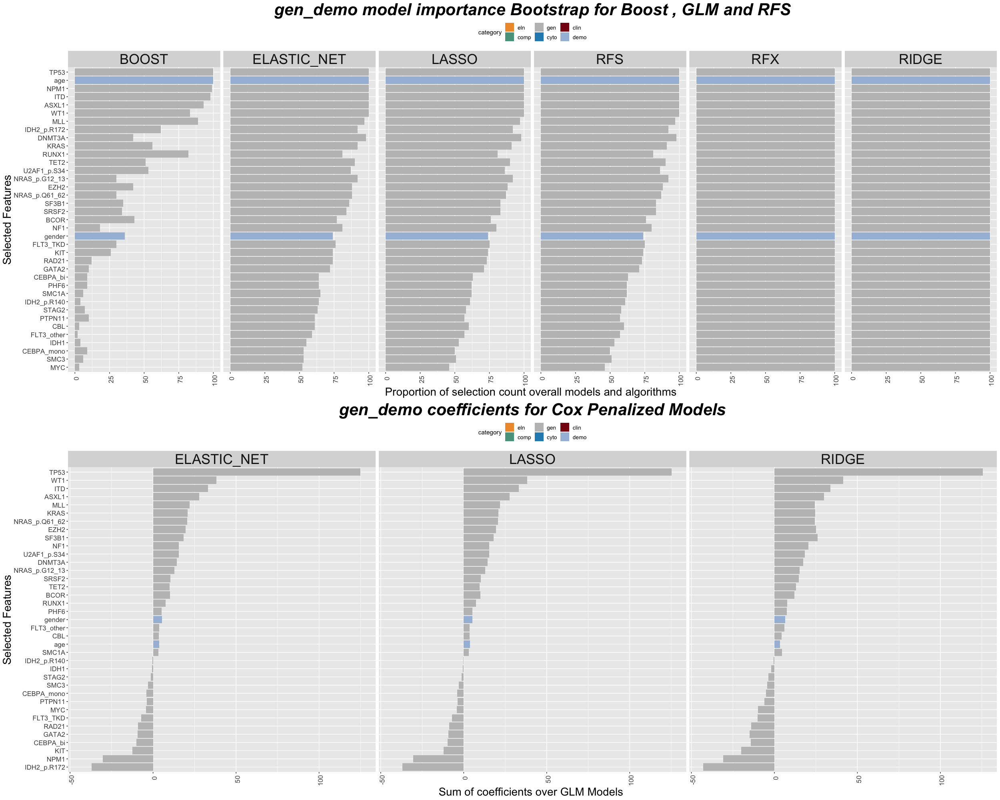

In [18]:
set_notebook_plot_size(25,20)
for (model in unique(df_bootstrap$model)){
    feature_model <- df_bootstrap[startsWith(df_bootstrap$model_algo,paste(model,"_bootstrap_",sep="")) ,] %>% filter(str_detect(model_algo, c("0.7|0|1|boost|rfs|rfx")))
    
    feature_model <- feature_model[,c('feature','sum_coef','num_selected','model_algo')] %>% group_by(feature,model_algo)  
    #%>% summarize_all(sum)
    
    feature_model$category <- ifelse(is.element(feature_model$feature,eln),"eln",
                                   ifelse(is.element(feature_model$feature,comp),"comp",
                                         ifelse(is.element(feature_model$feature,gen),"gen",
                                               ifelse(is.element(feature_model$feature,cyto),"cyto",
                                                     ifelse(is.element(feature_model$feature,clin),"clin","demo")))))

    feature_model$model_algo <- toupper(gsub(".*_bootstrap_", "",feature_model$model_algo ))
    feature_model$model_algo <- ifelse(feature_model$model_algo=="GLM_0","RIDGE",
                                      ifelse(feature_model$model_algo=="GLM_0.7","ELASTIC_NET",
                                            ifelse(feature_model$model_algo=="GLM_1","LASSO",feature_model$model_algo)))
    
    p <- ggplot(na.omit(feature_model %>% filter(str_detect(model_algo, c("LASSO|RIDGE|ELASTIC_NET|BOOST|RFS|RFX")))),aes(x=reorder(feature,num_selected),y=num_selected,fill=category))+geom_bar(stat = "identity")+facet_wrap(~model_algo,ncol=6)+
    theme(plot.title = element_text( size=30, face="bold.italic",hjust=0.5),legend.text=element_text(size=10),legend.position="top",
      axis.text.x = element_text(angle = 90, hjust = 0.8,vjust=0.8,size=12),axis.text.y=element_text(size=12),
      axis.title.y = element_text(size = 20),axis.title.x = element_text(size = 20),strip.text = element_text(size=25))+xlab("Selected Features") +
    ylab("Proportion of selection count overall models and algorithms ") + ggtitle(paste(model, "model importance Bootstrap for Boost , GLM and RFS"))+coord_flip() +scale_fill_manual(values=pal,limits=names(pal))

    q <-  ggplot(na.omit(feature_model %>% filter(str_detect(model_algo, c("LASSO|RIDGE|ELASTIC_NET")))),aes(x=reorder(feature,sum_coef),y=sum_coef,fill=category))+geom_bar(stat = "identity")+facet_wrap(~model_algo,ncol=5)+
    theme(plot.title = element_text( size=30, face="bold.italic",hjust=0.5),legend.text=element_text(size=10),legend.position="top",
      axis.text.x = element_text(angle = 90, hjust = 0.8,vjust=0.8,size=12),axis.text.y=element_text(size=12),
      axis.title.y = element_text(size = 20),axis.title.x = element_text(size = 20),strip.text = element_text(size=25))+xlab("Selected Features") +
    ylab("Sum of coefficients over GLM Models ") + ggtitle(paste(model, "coefficients for Cox Penalized Models"))+coord_flip() +scale_fill_manual(values=pal,limits=names(pal))
    
    grid.arrange(p,q,nrow=2)
}


# Impact of Age on SRSF2 and TET2

In [9]:
all_features <- df_bootstrap[startsWith(df_bootstrap$model_algo,"eln_comp_gen_cyto_clin_demo_bootstrap_glm"),]
all_features <- all_features[,c('feature','sum_coef','num_selected')] %>% group_by(feature) %>% summarize_all(sum)
all_features$proportion_selected <- all_features$num_selected /3
all_features$model <- "all_features"

all_features_without_age <- df_bootstrap[startsWith(df_bootstrap$model_algo,"eln_comp_gen_cyto_clin_demo_without_age_bootstrap_glm"),]
all_features_without_age <- all_features_without_age[,c('feature','sum_coef','num_selected')] %>% group_by(feature) %>% summarize_all(sum)
all_features_without_age$proportion_selected <- all_features_without_age$num_selected /3
all_features_without_age$model <- "all_features_without_age"
tmp <-rbind(all_features,all_features_without_age)
head(tmp)

feature,sum_coef,num_selected,proportion_selected,model
ahd,-1.015767e+02,300,100.00000,all_features
bm_blasts,3.659154e-01,232,77.33333,all_features
hb,-7.166111e-03,190,63.33333,all_features
perf_status,6.143603e+01,300,100.00000,all_features
plt,-7.432858e-02,235,78.33333,all_features
secondary,9.086894e+00,189,63.00000,all_features


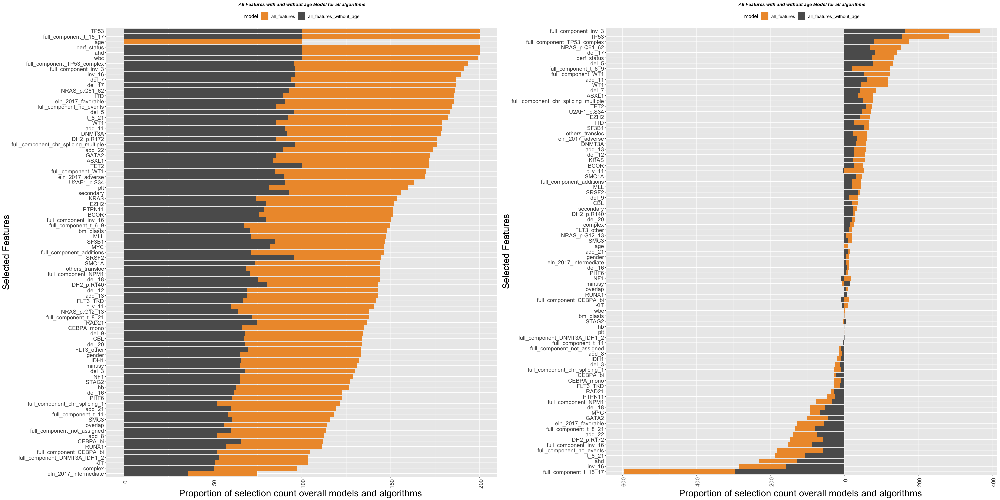

In [10]:
set_notebook_plot_size(30,15)
p <- ggplot(na.omit(tmp),aes(x=reorder(feature,proportion_selected),y=proportion_selected,fill=model))+geom_bar(stat = "identity")+
theme(plot.title = element_text( size=10, face="bold.italic",hjust=0.5),legend.text=element_text(size=10),legend.position="top",axis.text.x = element_text(angle = 90, hjust = 0.8,vjust=0.8,size=12),axis.text.y=element_text(size=12),axis.title.y = element_text(size = 20),axis.title.x = element_text(size = 20))+xlab("Selected Features") +
ylab("Proportion of selection count overall models and algorithms ") + ggtitle("All Features with and without age Model for all algorithms") + scale_fill_manual(values=c("#EE9937","#5C5C5C"))+coord_flip()
q <- ggplot(na.omit(tmp),aes(x=reorder(feature,sum_coef),y=sum_coef,fill=model))+geom_bar(stat = "identity")+
theme(plot.title = element_text( size=10, face="bold.italic",hjust=0.5),legend.text=element_text(size=10),legend.position="top",axis.text.x = element_text(angle = 90, hjust = 0.8,vjust=0.8,size=12),axis.text.y=element_text(size=12),axis.title.y = element_text(size = 20),axis.title.x = element_text(size = 20))+xlab("Selected Features") +
ylab("Proportion of selection count overall models and algorithms ") + ggtitle("All Features with and without age Model for all algorithms") + scale_fill_manual(values=c("#EE9937","#5C5C5C"))+coord_flip()
grid.arrange(p,q,ncol=2)


In [11]:
dim(df[df$TP53==1 & df$complex==1,])

ERROR: Error in df$TP53: object of type 'closure' is not subsettable
